### Visualizing TFIDF Models of the Arab Observer

This notebook contains the required code to make visualizations to analyze TFIDF models of the Arab Observer

In [21]:
import pandas as pd
import altair as alt
alt.renderers.enable('notebook')
alt.data_transformers.enable('default', max_rows=None)
from sklearn.feature_extraction.text import TfidfVectorizer
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import ast

In [43]:
# Read in required datasets
# Full Corpus
full_corpus_df = pd.read_csv('./data/arab_observer_corpus_cleaned.csv')
#Distinguish origin of data 
full_corpus_df.type[full_corpus_df.type == 'hathi_trust'] = 'HathiTrust Volumes'
full_corpus_df.type[full_corpus_df.type == 'collected_issues'] = 'Collected Issues'
full_corpus_df.sort_values(by=['datetime', 'binned', 'page_number'], inplace=True)
#Order datasets temporally
full_corpus_df['date_bin'] = full_corpus_df.date.astype(str)+'_'+full_corpus_df.binned.astype(str)
full_corpus_df['date_page'] = full_corpus_df.date.astype(str)+'_'+full_corpus_df.page_number.astype(str)
full_corpus_dates = full_corpus_df.date.unique().tolist()

# Congo Corpus
congo_corpus_df = pd.read_csv('./data/arab_observer_congo_corpus.csv')
congo_corpus_df['date_bin'] = congo_corpus_df.date.astype(str)+'_'+congo_corpus_df.binned.astype(str)
congo_corpus_df['date_page'] = congo_corpus_df.date.astype(str)+'_'+congo_corpus_df.page_number.astype(str)
congo_corpus_dates = congo_corpus_df.date.unique().tolist()
congo_corpus_df['datetime'] = pd.to_datetime(congo_corpus_df['date'], format='%Y-%B-%d', errors='coerce')
congo_corpus_df = congo_corpus_df.sort_values(by=['datetime', 'page_number'])

Function for comparing TFIDF models

In [31]:
def normalize_texts(original_df):
    original_df_texts = ' '.join(original_df.token_texts)
    original_df_texts = original_df_texts.split(' ')
    val = round(len(original_df_texts) / len(original_df))
    text = []
    for i in range(0, len(original_df_texts), val):
        chunk = ' '.join(original_df[i:i + val])
        if i + val + val > len(original_df_texts):
            chunk = ' '.join(original_df_texts[i:])
            text.append(chunk)
            break
        text.append(chunk)
    split_original_df = pd.DataFrame({'token_texts': text})
    split_original_df['token_counts'] = split_original_df.token_texts.str.split().str.len()
    split_original_df['doc'] = split_original_df.index
    return split_original_df

In [53]:
def create_tfidf_model(df, ngr, model_identifier, max_terms, maxdf=1.0):
    
    vectorizer = TfidfVectorizer(ngram_range=ngr, max_df=maxdf)
    docs = vectorizer.fit_transform(df.cleaned_spacy_text.tolist())
    features = vectorizer.get_feature_names()
    count = np.squeeze(np.asarray(docs.sum(axis=0)))
    sorted_count = count.argsort()[::-1]
    dist_df =pd.DataFrame({'freq': count, 'term':np.array(features)})
    dist_df['type'] = model_identifier
    dist_df['freqz'] = dist_df[['freq']].apply(lambda x: (x-x.min())/(x.max()-x.min())+ 0.000001)
    dist_df.sort_values(by=['freqz'], inplace=True, ascending=False)
    df2 = pd.DataFrame(docs.toarray(), columns = features)
    df3 = df2.T
    df3['term'] = df3.index
    df3.reset_index(inplace=True, drop=True)
    df_melted = df3.melt('term', value_name='value', var_name='doc')

    df_merged = dist_df.merge(df_melted, on='term', how='inner')
    df_terms = df_merged.copy()
    df_terms = df_terms.drop_duplicates('term')
    
    return df_terms[0:max_terms]

In [37]:
def get_distribution(df):
    chart = alt.Chart(df).mark_bar().encode(
        y=alt.Y('date_page:O',
                sort=alt.EncodingSortField(
                field="cleaned_nltk_counts",  # The field to use for the sort
                op="sum",  # The operation to run on the field prior to sorting
                order="descending"  # The order to sort in
            )
        ),
        x='cleaned_nltk_counts:Q'
    ).properties(
        height=250
    )
    return chart

In [ ]:
df_terms = {
    'first_df_type': 'early corpus',
    'second_df_type': 'late corpus',
    'third_df_type': 'common both corpuses'
}

First visualization of TF-IDF model for June 26th, 1960 issue of Arab Observer compared to normalized version

In [45]:
df_june = full_corpus_df.loc[full_corpus_df.date.str.contains('June')]


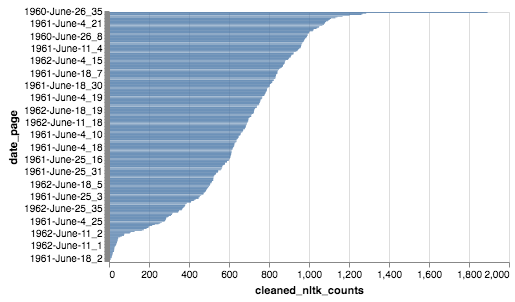

In [46]:
chart_june = get_distribution(df_june)
chart_june

In [54]:
tfidf_june = create_tfidf_model(df_june, (1,2), 'june_original_issue', 50)

terms = tfidf_june.term.tolist()
frames = []
for t in terms:
    rows = df_june.loc[df_june.cleaned_spacy_text.str.contains(t) == True].copy()
    rows['counts'] = rows.cleaned_spacy_text.str.count(t)
    rows['term'] = t
    rows = rows[['date', 'page_number', 'counts', 'term']]
    frames.append(rows)
df_june_counts = pd.concat(frames, ignore_index=True)

alt.themes.enable('opaque')
total_freq = alt.Chart(tfidf_june).mark_bar().encode(
    x=alt.X('sum(freq):Q', axis=alt.Axis(title='weight')),
    y=alt.Y(
        'term:N',
         sort=terms
    ),

).properties(
    width=200,
    height=280,
    title='Frequency of Terms in "Africa To-Day"'
)

page_freq2 = alt.Chart(june_counts_df).mark_tick().encode(
    x=alt.X('page_number:O', axis=alt.Axis(title='page number')),
    y=alt.Y(
        'term:N',
         sort=terms
    ),
    color=alt.Color('sum(counts):Q', scale=alt.Scale(scheme='plasma')),

).properties(
    width=200, title='Distribution and frequencies of terms by page'
)


charts = alt.hconcat(total_freq | page_freq )

In [ ]:
norm_june = normalize_texts(df_june)
chart_norm_june = get_distribution(norm_june)
chart_norm_june

In [ ]:
tfidf_normjune = create_tfidf_model(split_june, (1,2), 'june_norm_issue', 50)

terms = tfidf_normjune.term.tolist()
frames = []
for t in terms:
    rows = norm_june.loc[norm_june.cleaned_spacy_text.str.contains(t) == True].copy()
    rows['counts'] = rows.cleaned_spacy_text.str.count(t)
    rows['term'] = t
    rows = rows[['date', 'page_number', 'counts', 'term']]
    frames.append(rows)
norm_june_counts = pd.concat(frames, ignore_index=True)

alt.themes.enable('opaque')
total_freq = alt.Chart(tfidf_normjune).mark_bar().encode(
    x=alt.X('sum(freq):Q', axis=alt.Axis(title='weight')),
    y=alt.Y(
        'term:N',
         sort=terms
    ),

).properties(
    width=200,
    height=280,
    title='Frequency of Terms in "Africa To-Day"'
)

page_freq2 = alt.Chart(norm_june_counts).mark_tick().encode(
    x=alt.X('page_number:O', axis=alt.Axis(title='page number')),
    y=alt.Y(
        'term:N',
         sort=order_terms2
    ),
    color=alt.Color('sum(counts):Q', scale=alt.Scale(scheme='plasma')),

).properties(
    width=200, title='Distribution and frequencies of terms by page'
)


charts = alt.hconcat(total_freq | page_freq )

Visualization of Summer 1960 full issues versus pages that mention Congo

Visualization of late 1960 pages that mention Congo versus pages from early 1961 that mention Congo

Visualization early 1960s Congo corpus versus later 1960s Congo corpus

In [77]:
df_congo = df_allcongo.loc[df_allcongo.date.str.contains('1960')]
df_congo_june = df_congo.loc[df_congo.date.str.contains('June')]
df_congo_june.drop_duplicates(inplace=True)
df_congo_july = df_congo.loc[df_congo.date.str.contains('July')]
df_congo_july.drop_duplicates(inplace=True)
df_congo_aug = df_congo.loc[df_congo.date.str.contains('August')]
df_congo_aug.drop_duplicates(inplace=True)

df_summer = pd.concat([df_congo_june, df_congo_july, df_congo_aug], ignore_index=True)
df_summer['datetime'] = pd.to_datetime(df_summer['date'], format='%Y-%B-%d', errors='coerce')
df_summer = df_summer.sort_values(by=['datetime', 'page_number'])
df_summer['idx'] = df_summer.index

df_summer['page_date'] = df_summer.date.astype(str)+'_'+df_summer.page_number.astype(str) 
order_dates = df_summer.page_date.unique().tolist()



df_1960 = input_df.loc[input_df.date.str.contains('1960') == True]
# df_1960.date.unique()
df_june = df_1960.loc[df_1960.date.str.contains('June')]
df_june.drop_duplicates(inplace=True)
df_july = df_1960.loc[df_1960.date.str.contains('July')]
df_july.drop_duplicates(inplace=True)
df_aug = df_1960.loc[df_1960.date.str.contains('Aug')]
df_aug.drop_duplicates(inplace=True)

df_sum = pd.concat([df_june, df_july, df_aug])
df_s = df_summer[['page_number', 'date', 'word_counts']]
df_test = df_sum.merge(df_s, on=['date', 'page_number'], how='left')
df_test['word_counts'].fillna(0, inplace=True)
df_test['datetime'] = pd.to_datetime(df_test['date'], format='%Y-%B-%d', errors='coerce')
df_test = df_test.sort_values(by=['datetime', 'page_number'])

df_test['page_date'] = df_test.date.astype(str)+'_'+df_test.page_number.astype(str) 
order_dates = df_test.page_date.unique().tolist()

NameError: name 'df_allcongo' is not defined

In [7]:
feature_time = pd.read_csv('../data/features_time_binary_classifier_maxdf30.csv')
feature_congo = pd.read_csv('../data/features_congo_binary_classifier_maxdf30_weighted.csv')

In [10]:
feature_time.coef_0 = feature_time.coef_0.abs()
feature_congo.coef_0 = feature_congo.coef_0.abs()

In [15]:
feature_time = feature_time[0:50]
feature_congo = feature_congo[0:50]
features = feature_congo.merge(feature_time, on='Unnamed: 0', how='outer')

In [19]:
feature_ec = feature_congo[['coef_0', 'feature_0']]
feature_ec['type'] = 'early congo'
feature_et = feature_time[['coef_0', 'feature_0']]
feature_et['type'] = 'early time'
feature_lc = feature_congo[['coef_1', 'feature_1']]
feature_lc['type'] = 'late congo'
feature_lt = feature_time[['coef_1', 'feature_1']]
feature_lt['type'] = 'late time'
feature_early = feature_ec.merge(feature_et, on='feature_0', how='outer')
feature_late = feature_lc.merge(feature_lt, on='feature_1', how='outer')
feature_early_1 = feature_early.corpus_type[(terms2.type_x.isna() == False) & (terms2.type_y.isna() == True)] =  comp1
    terms2.corpus_type[(terms2.type_x.isna() == True) & (terms2.type_y.isna() == False)] = comp2

In [30]:
feature_early_both = feature_early.loc[(feature_early.type_x.isna() == False) & (feature_early.type_y.isna() == False)]
feature_late_both = feature_late.loc[(feature_late.type_x.isna() == False) & (feature_late.type_y.isna() == False)]

In [50]:
feature_late_1 = feature_late.loc[feature_late.type_x == 'late congo']
feature_late_1.type_x[feature_late_1.type_y == 'late time'] = 'both corpuses'
feature_late_2 = feature_late.loc[feature_late.type_y == 'late time']
feature_late_2.type_y[feature_late_2.type_x == 'late congo'] = 'both corpuses'

In [54]:
feature_late.columns

Index(['coef_1_x', 'feature_1', 'type_x', 'coef_1_y', 'type_y'], dtype='object')

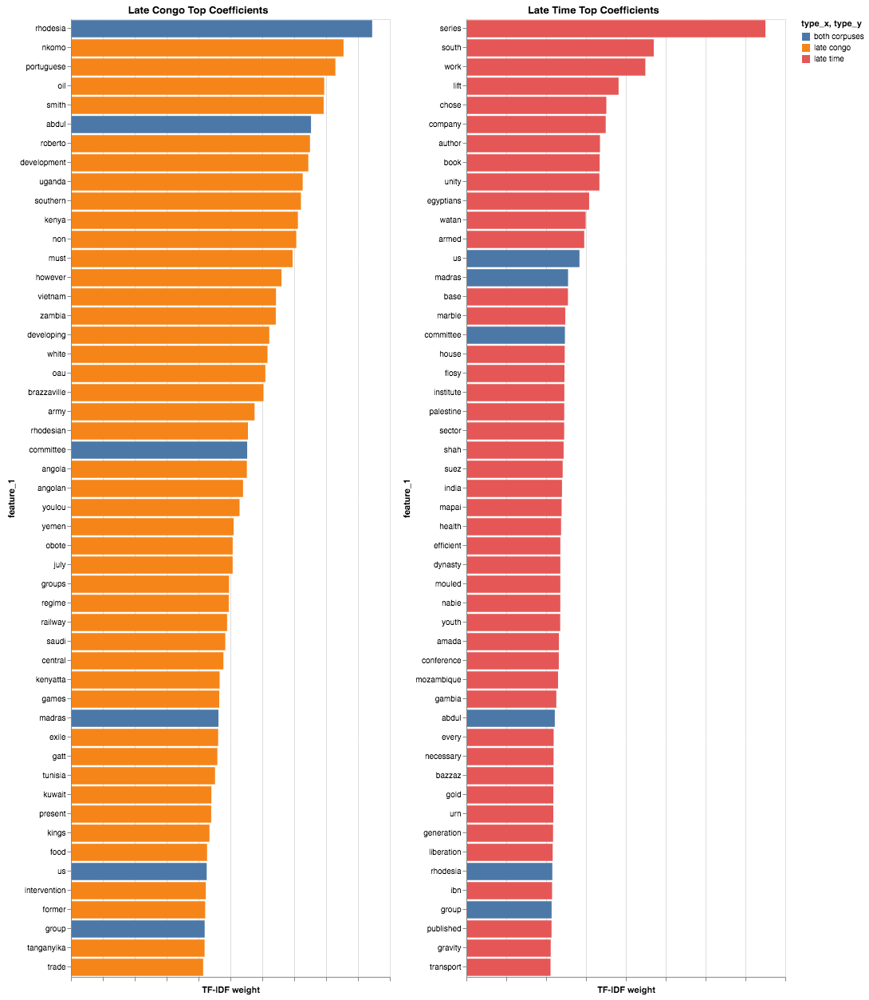

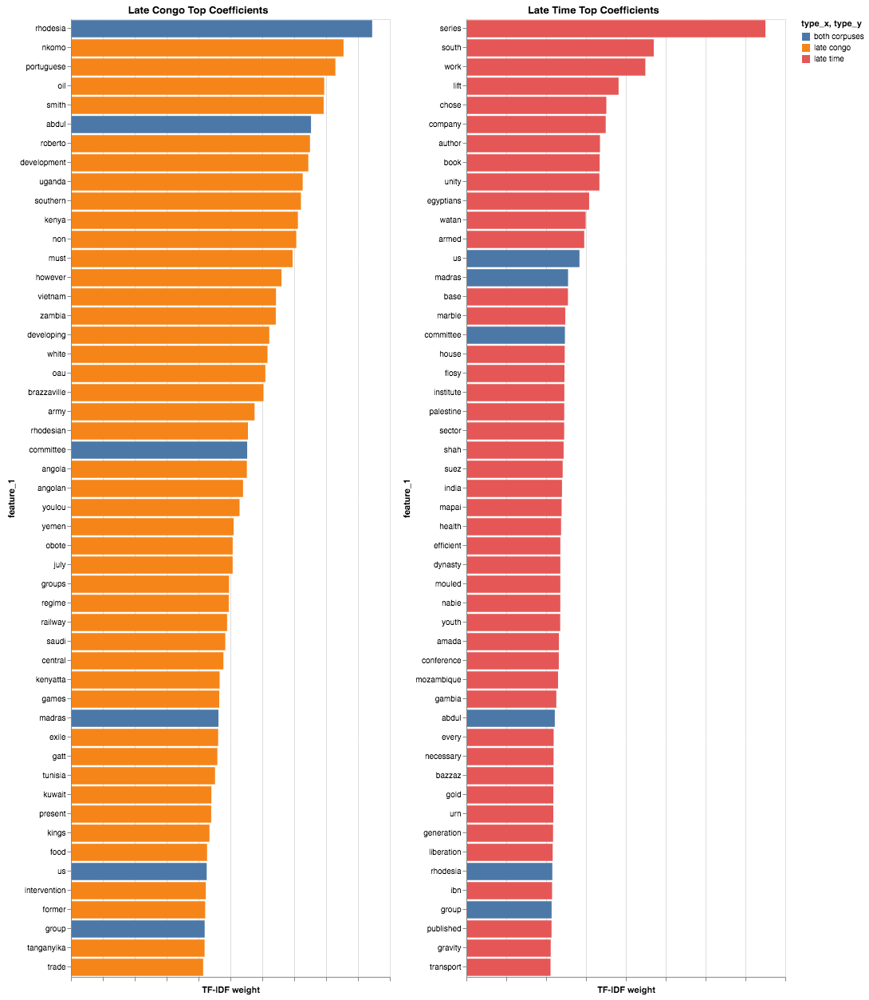

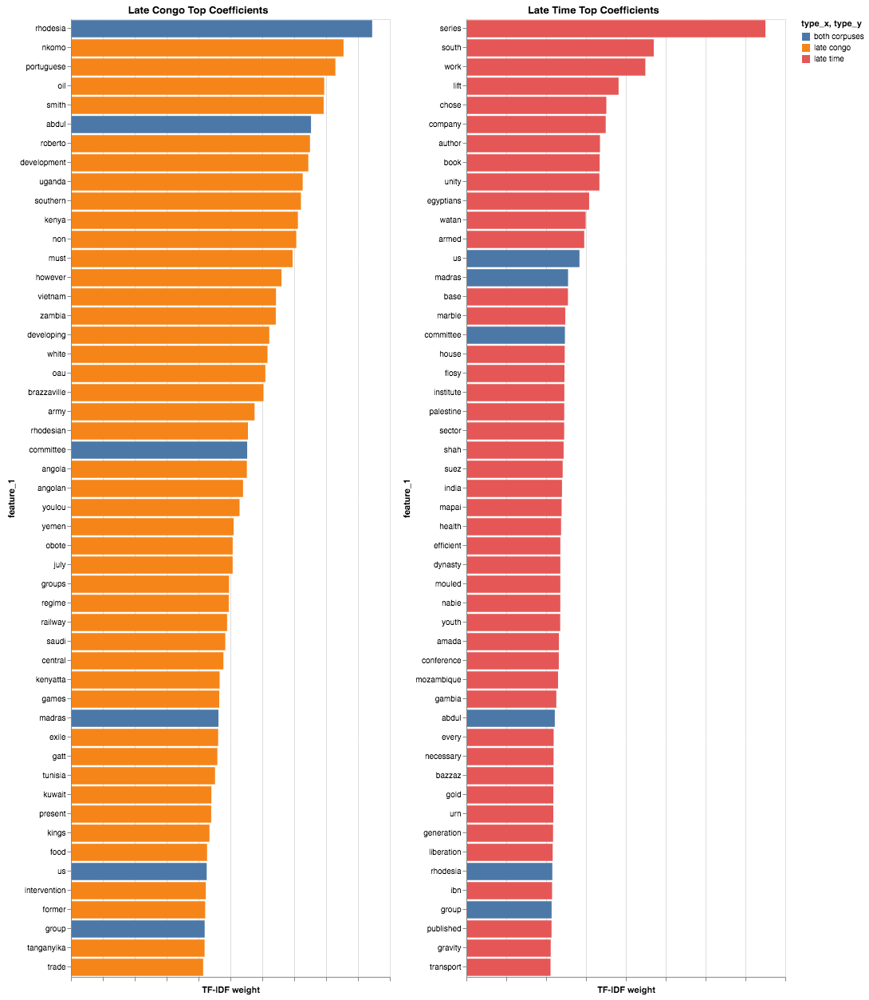

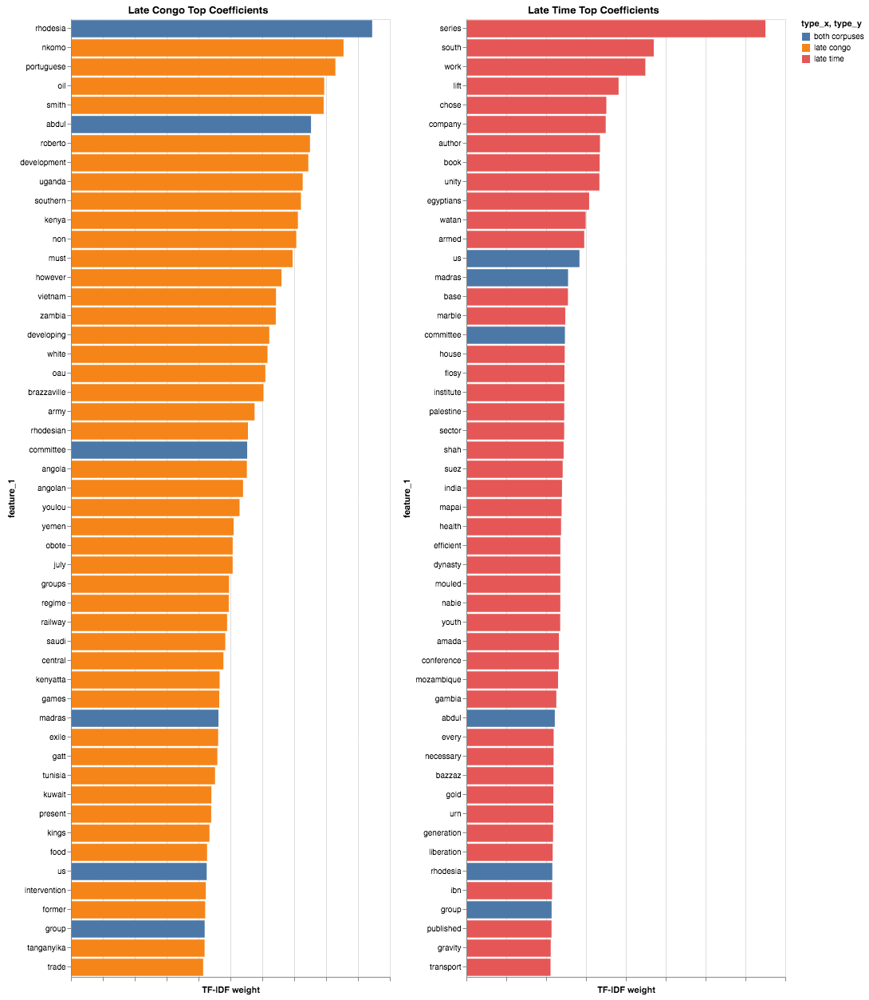

In [56]:



total_freq2 = alt.Chart(feature_late_1).mark_bar().encode(
    x=alt.X('coef_1_x:Q', axis=alt.Axis(title='TF-IDF weight')),
    y=alt.Y(
        'feature_1:N',
         sort=alt.EncodingSortField(
            field="coef_1_x",  # The field to use for the sort
            op="sum",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )
    ),
    color='type_x:N'

).properties(title='Late Congo Top Coefficients', height=1200)


congo_freq2 = alt.Chart(feature_late_2).mark_bar().encode(
    x=alt.X('coef_1_y:Q', axis=alt.Axis(title='TF-IDF weight')),
    y=alt.Y(
        'feature_1:N',
         sort=alt.EncodingSortField(
            field="coef_1_y",  # The field to use for the sort
            op="sum",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )
    ),
    color='type_y:N'

).properties(title='Late Time Top Coefficients', height=1200)

alt.themes.enable('opaque')
alt.hconcat(total_freq2 | congo_freq2 ).configure_axisX(labelAngle=0, labels=False)



In [78]:
df_allcongo = pd.read_csv('../data/all_congo_pages_cleaned.csv')
df_allcongo = df_allcongo.drop('token_texts', axis=1)
df_allcongo.rename(columns={'cleaned_texts': 'token_texts'}, inplace=True)

In [79]:
df_allcongo['token_counts'] = df_allcongo.token_texts.str.split().str.len()

In [80]:
df_congos = df_allcongo
df_congos.drop_duplicates(inplace=True)
df_congos['datetime'] = pd.to_datetime(df_congos['date'], format='%Y-%B-%d', errors='coerce')
df_congos = df_congos.sort_values(by=['datetime', 'page_number'])
df_congos['page_date'] = df_congos.date.astype(str)+'_'+df_congos.binned.astype(str) +'_'+df_congos.page_number.astype(str) 
df_congos['date_bin'] = df_congos.date.astype(str)+'_'+df_congos.binned.astype(str) 
order_dates = df_congos.page_date.unique().tolist()


In [81]:

input_df = pd.read_csv('../data/all_pages_corpus_cleaned.csv')
input_df[['token_texts']] = input_df[['token_texts']].fillna(value='')
input_df['token_counts'] = input_df.token_texts.str.split().str.len()
input_df['datetime'] = pd.to_datetime(input_df['date'], format='%Y-%B-%d', errors='coerce')

In [11]:
input_df.to_csv('../data/all_pages_corpus_cleaned.csv')

In [70]:
input_df['type'] = '' 
input_df.type[input_df.date > '1962-12-31'] = 'HathiTrust Volumes'
input_df.type[input_df.date < '1963-01-01'] = 'Collected Issues'
input_df['date_bin'] = input_df.date.astype(str)+'_'+input_df.binned.astype(str)
input_df.sort_values(by=['datetime', 'binned', 'page_number'], inplace=True)
order_dates = input_df.date.unique().tolist()

In [82]:
df_congo = df_allcongo.loc[df_allcongo.date.str.contains('1960')]
df_congo_june = df_congo.loc[df_congo.date.str.contains('June')]
df_congo_june.drop_duplicates(inplace=True)
df_congo_july = df_congo.loc[df_congo.date.str.contains('July')]
df_congo_july.drop_duplicates(inplace=True)
df_congo_aug = df_congo.loc[df_congo.date.str.contains('August')]
df_congo_aug.drop_duplicates(inplace=True)

df_summer = pd.concat([df_congo_june, df_congo_july, df_congo_aug], ignore_index=True)
df_summer['datetime'] = pd.to_datetime(df_summer['date'], format='%Y-%B-%d', errors='coerce')
df_summer = df_summer.sort_values(by=['datetime', 'page_number'])
df_summer['idx'] = df_summer.index

df_summer['page_date'] = df_summer.date.astype(str)+'_'+df_summer.page_number.astype(str) 
order_dates = df_summer.page_date.unique().tolist()



df_1960 = input_df.loc[input_df.date.str.contains('1960') == True]
# df_1960.date.unique()
df_june = df_1960.loc[df_1960.date.str.contains('June')]
df_june.drop_duplicates(inplace=True)
df_july = df_1960.loc[df_1960.date.str.contains('July')]
df_july.drop_duplicates(inplace=True)
df_aug = df_1960.loc[df_1960.date.str.contains('Aug')]
df_aug.drop_duplicates(inplace=True)

df_sum = pd.concat([df_june, df_july, df_aug])
df_s = df_summer[['page_number', 'date', 'word_counts']]
df_test = df_sum.merge(df_s, on=['date', 'page_number'], how='left')
df_test['word_counts'].fillna(0, inplace=True)
df_test['datetime'] = pd.to_datetime(df_test['date'], format='%Y-%B-%d', errors='coerce')
df_test = df_test.sort_values(by=['datetime', 'page_number'])

df_test['page_date'] = df_test.date.astype(str)+'_'+df_test.page_number.astype(str) 
order_dates = df_test.page_date.unique().tolist()

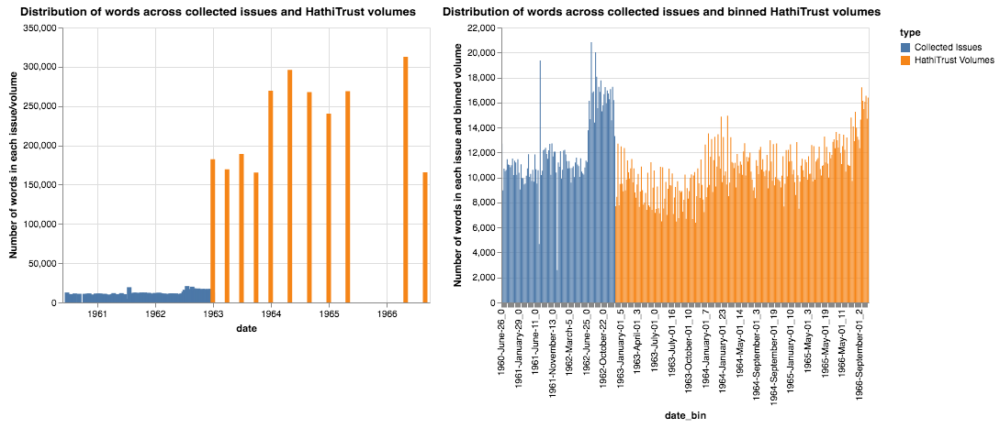

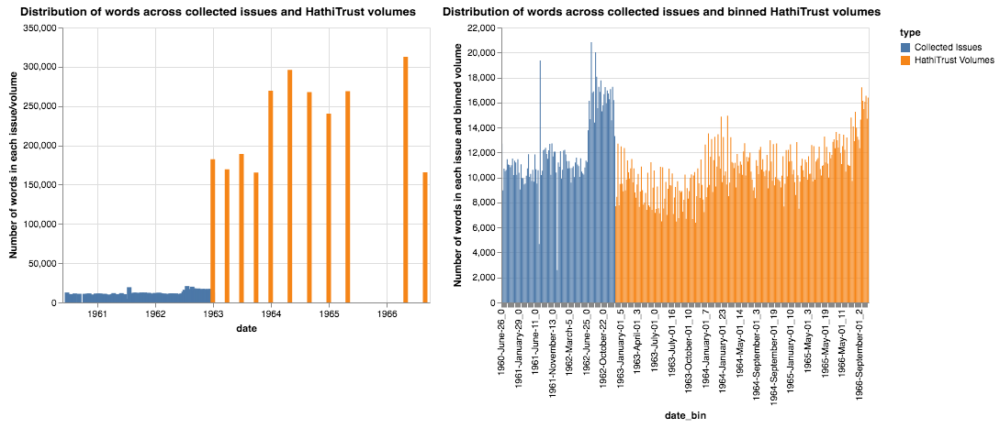

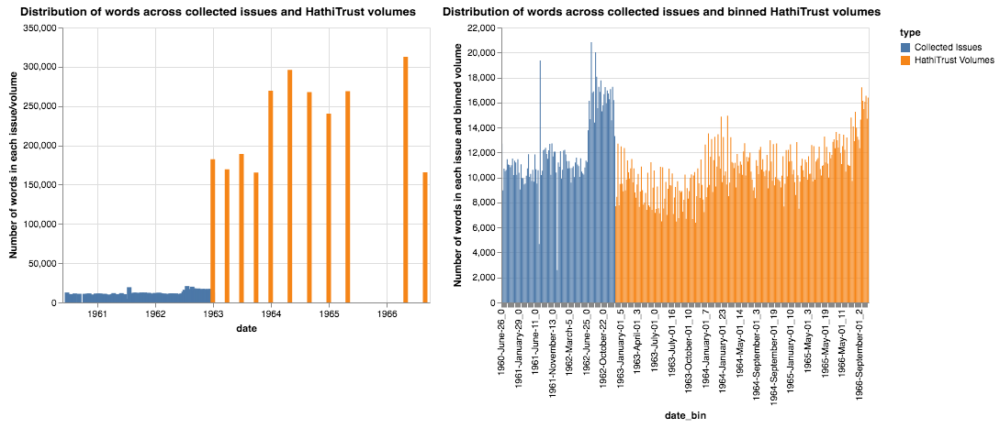

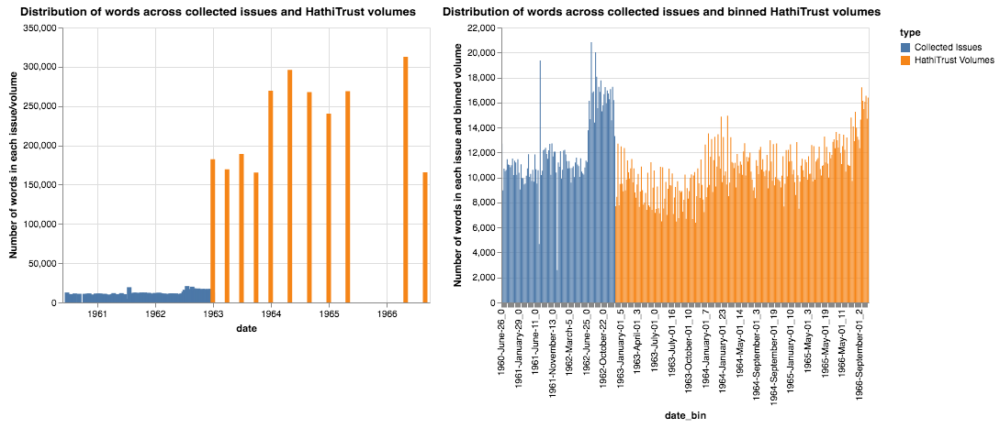

In [76]:
chart = alt.Chart(input_df).mark_bar().encode(
    x=alt.X('date:T', sort=order_dates),
    y=alt.Y('sum(token_counts):Q', axis=alt.Axis(title='Number of words in each issue/volume')),
    color='type:N'
).properties(
    title='Distribution of words across collected issues and HathiTrust volumes'
)
chart1 = alt.Chart(input_df).mark_bar().encode(
    x=alt.X('date_bin:O', sort=order_dates),
    y=alt.Y('sum(token_counts):Q', axis=alt.Axis(title='Number of words in each issue and binned volume')),
    color='type:N'
).properties(
    title='Distribution of words across collected issues and binned HathiTrust volumes',
    width=400
)
chart | chart1

In [11]:
df_congo = df_allcongo.loc[df_allcongo.date.str.contains('1960')]
df_congo_june = df_congo.loc[df_congo.date.str.contains('June')]
df_congo_june.drop_duplicates(inplace=True)
df_congo_july = df_congo.loc[df_congo.date.str.contains('July')]
df_congo_july.drop_duplicates(inplace=True)
df_congo_aug = df_congo.loc[df_congo.date.str.contains('August')]
df_congo_aug.drop_duplicates(inplace=True)

df_summer = pd.concat([df_congo_june, df_congo_july, df_congo_aug], ignore_index=True)
df_summer['datetime'] = pd.to_datetime(df_summer['date'], format='%Y-%B-%d', errors='coerce')
df_summer = df_summer.sort_values(by=['datetime', 'page_number'])
df_summer['idx'] = df_summer.index

df_summer['page_date'] = df_summer.date.astype(str)+'_'+df_summer.page_number.astype(str) 
order_dates = df_summer.page_date.unique().tolist()



df_1960 = input_df.loc[input_df.date.str.contains('1960') == True]
# df_1960.date.unique()
df_june = df_1960.loc[df_1960.date.str.contains('June')]
df_june.drop_duplicates(inplace=True)
df_july = df_1960.loc[df_1960.date.str.contains('July')]
df_july.drop_duplicates(inplace=True)
df_aug = df_1960.loc[df_1960.date.str.contains('Aug')]
df_aug.drop_duplicates(inplace=True)

df_sum = pd.concat([df_june, df_july, df_aug])
df_s = df_summer[['page_number', 'date', 'word_counts']]
df_test = df_sum.merge(df_s, on=['date', 'page_number'], how='left')
df_test['word_counts'].fillna(0, inplace=True)
df_test['datetime'] = pd.to_datetime(df_test['date'], format='%Y-%B-%d', errors='coerce')
df_test = df_test.sort_values(by=['datetime', 'page_number'])

df_test['page_date'] = df_test.date.astype(str)+'_'+df_test.page_number.astype(str) 
order_dates = df_test.page_date.unique().tolist()
# df_test.token_texts = df_test.token_texts.astype(str)

In [83]:
# early_congo = df_allcongo.loc[df_allcongo.datetime < '1960-12-01']
# late_congo = df_allcongo.loc[(df_allcongo.datetime > '1960-12-01') & (df_allcongo.datetime < '1961-03-01')]
# late_congo = df_allcongo.loc[(df_allcongo.datetime > '1962-12-31')]
# early_congo = df_allcongo.loc[(df_allcongo.datetime < '1963-01-01')]
late_congo = df_test.copy()
early_congo= df_summer.copy()

df_terms = {
    'first_df_type': 'early corpus',
    'second_df_type': 'late corpus',
    'third_df_type': 'common both corpuses'
}
len(late_congo) + len(early_congo), len(df_allcongo)

(251, 857)

In [14]:
order_dates = early_congo.date.unique().tolist()

In [59]:
## Tests to figure out distribution of documents impact

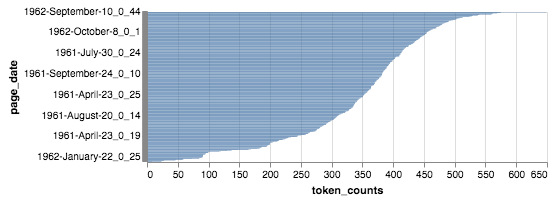

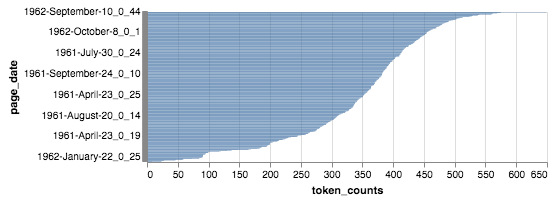

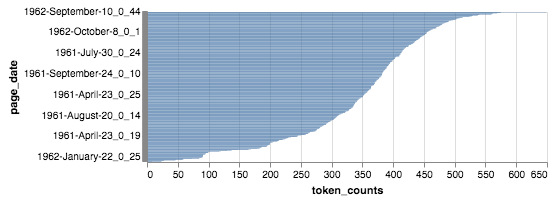

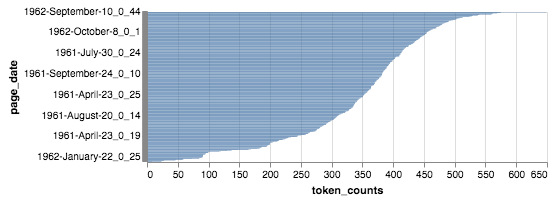

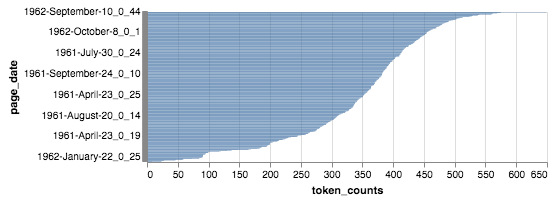

In [356]:
alt.Chart(early_congo).mark_bar().encode(
    y=alt.Y('page_date:O',
            sort=alt.EncodingSortField(
            field="token_counts",  # The field to use for the sort
            op="sum",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )
    ),
    x='token_counts:Q'
).properties(
    height=150
)

In [53]:
from scipy.stats import variation

variation(early_congo.token_counts), early_congo.token_counts.skew(), early_congo.token_counts.kurtosis()

(0.33163263703575513, -0.7389830639031201, 0.441357284690449)

In [61]:
variation(late_congo.token_counts), late_congo.token_counts.skew(), late_congo.token_counts.kurtosis()

(0.31799579268184686, -0.3544583430769857, -0.12103428664312554)

In [90]:
late_congo_texts = ' '.join(late_congo.token_texts)
late_congo_texts = late_congo_texts.split(' ')

In [91]:
val = round(len(late_congo_texts) / len(late_congo))
text1 = []
for i in range(0, len(late_congo_texts), val):
    chunk = ' '.join(late_congo_texts[i:i + val])
    if (i + val + val) > len(late_congo_texts):
        chunk = ' '.join(late_congo_texts[i:])
        text1.append(chunk)
        break
    text1.append(chunk)


In [92]:
df_splitlate_congo = pd.DataFrame({'token_texts': text1})

In [93]:
df_splitlate_congo['token_counts'] = df_splitlate_congo.token_texts.str.split().str.len()
df_splitlate_congo['doc'] = df_splitlate_congo.index

In [66]:
## SECOND COrPUS

In [94]:
## Test Two Vectorizers (One split and one without split) with different parameters
vectorizer4 = TfidfVectorizer(ngram_range=(1,2))
docs4 = vectorizer4.fit_transform(df_splitlate_congo.token_texts.tolist())
#     cos = 1- cosine_similarity(docs)
features4 = vectorizer4.get_feature_names()
count4 = np.squeeze(np.asarray(docs4.sum(axis=0)))
sorted_count4 = count4.argsort()[::-1]
# freqs3 = [count3[i] for i in sorted_count3]
# words3 = [np.array(features3)[i] for i in sorted_count3]
dist_df4 =pd.DataFrame({'freq': count4, 'term':np.array(features4)})
#     dist_df['date'] = date
dist_df4['type'] = df_terms['second_df_type']
dist_df4['freqz'] = dist_df4[['freq']].apply(lambda x: (x-x.min())/(x.max()-x.min())+ 0.000001)
dist_df4.sort_values(by=['freqz'], inplace=True, ascending=False)
dist_df4.reset_index(drop=True, inplace=True)
# dist_df = dist_df[0:50]

# df = pd.DataFrame(docs.toarray(), columns = features)
 

In [95]:
df6 = pd.DataFrame(docs4.toarray(), columns = features4)
df7 = df6.T
df7['term'] = df7.index
df7.reset_index(inplace=True, drop=True)
df_melted4 = df7.melt('term', value_name='value', var_name='doc')

test4 = dist_df4.merge(df_melted4, on='term', how='inner')

In [96]:
test4_terms = test4.copy()
test4_terms = test4_terms.drop_duplicates('term')
test4_terms = test4_terms[0:200]

In [29]:
### ALL COMPARISONS

In [101]:

t2 = test2_terms.copy()
t2 = t2[0:50]
t4 = test4_terms.copy()
t4 = t4[0:50]

In [102]:

t2.type = 'congo split'
t4.type = 'summer split'

In [103]:

t2t4 = t2.merge(t4, on=['term'], how='outer')

In [104]:
def shape_corpus(terms2, comp1, comp2):
    terms2['corpus_type'] = ''
    terms2.corpus_type[(terms2.type_x.isna() == False) & (terms2.type_y.isna() == True)] =  comp1
    terms2.corpus_type[(terms2.type_x.isna() == True) & (terms2.type_y.isna() == False)] = comp2
    terms2.corpus_type[(terms2.type_x.isna() == False) & (terms2.type_y.isna() == False)] = df_terms['third_df_type']
    first_df2 = terms2.loc[terms2.type_x == comp1]
    second_df2 = terms2.loc[terms2.type_y == comp2]
    dist_both2 = terms2.loc[terms2.corpus_type == df_terms['third_df_type']]
    return first_df2, second_df2, dist_both2

In [105]:
t2t4_1, t2t4_2, t2t4_both = shape_corpus(t2t4, 'congo split', 'summer split')

In [106]:

t2t4_both['abs_change'] = t2t4_both.freqz_x - t2t4_both.freqz_y
t2t4_both.abs_change = t2t4_both.abs_change.abs()
# t1t2_both['abs_change'] = t1t2_both.freqz_x - t1t2_both.freqz_y
# t1t2_both.abs_change = t1t2_both.abs_change.abs()

In [107]:
def get_counts_full(term):
#     rows = early_congo.loc[early_congo.str.contains(term) == True].copy()
#     counts = rows.token_texts.str.count(term).sum()
    rows1 = df_splitlate_congo.loc[df_splitlate_congo.token_texts.str.contains(term) == True].copy()
    counts1 = rows1.token_texts.str.count(term).sum()
    return counts1

t2t4_both['counts'] = t2t4_both.term.apply(get_counts_full)

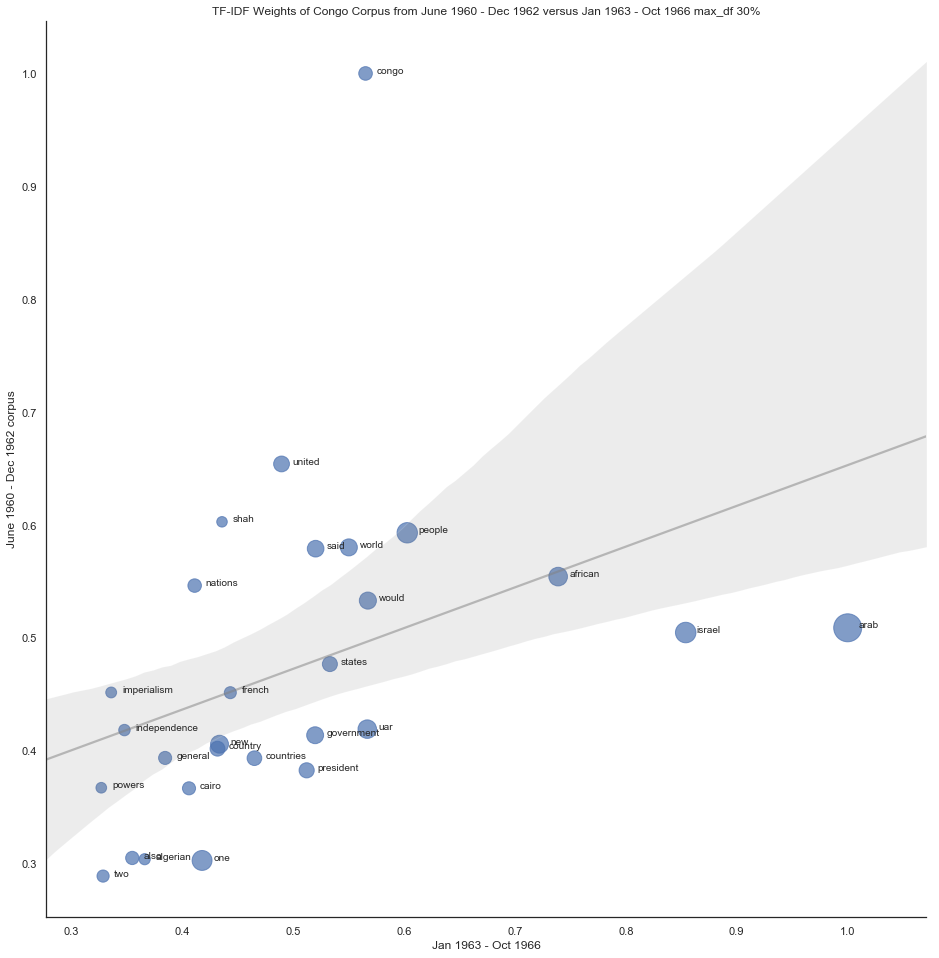

In [109]:
import seaborn as sns
sns.set_style("white")
%matplotlib inline
# plt.rcParams['figure.figsize']=(1000,1000)
g = sns.lmplot(x='freqz_y', y='freqz_x', data=t2t4_both, ci=90, scatter_kws={'s':t2t4_both.counts,'alpha':0.7, }, line_kws={'color':'grey', 'alpha':0.5});
g.fig.set_size_inches(15,15)
axes = g.axes.flatten()
axes[0].set_title('TF-IDF Weights of Congo Corpus from June 1960 - Dec 1962 versus Jan 1963 - Oct 1966 max_df 30%')
axes[0].set_ylabel('June 1960 - Dec 1962 corpus')
axes[0].set_xlabel('Jan 1963 - Oct 1966')

def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+.01, point['y'], str(point['val']))
        
    
# labels = t2t4_both.loc[t2t4_both.abs_change > t2t4_both.abs_change.median()]
# label_point(labels.freqz_y, labels.freqz_x, labels.term, plt.gca())
label_point(t2t4_both.freqz_y, t2t4_both.freqz_x, t2t4_both.term, plt.gca())
plt.savefig('summerfull1960_50words.png')

In [60]:
t2t4_both

,freq_x,term,type_x,freqz_x,doc_x,value_x,freq_y,type_y,freqz_y,doc_y,value_y,corpus_type,abs_change,counts
0,18.975489,congo,congo split,1.000001,0,0.078233,10.706206,summer split,0.588909,0,0.012425,common both corpuses,0.411092,1192
1,18.109168,african,congo split,0.954243,0,0.031611,18.156963,summer split,1.000001,0,0.014685,common both corpuses,0.045758,1526
2,15.117747,united,congo split,0.796241,0,0.061393,7.171455,summer split,0.393880,0,0.000000,common both corpuses,0.402361,409
3,14.553334,uar,congo split,0.766430,0,0.000000,8.989098,summer split,0.494168,0,0.093746,common both corpuses,0.272262,724
4,14.183825,said,congo split,0.746913,0,0.015177,9.888614,summer split,0.543798,0,0.000000,common both corpuses,0.203115,636
5,13.362182,nations,congo split,0.703515,0,0.049408,6.214059,summer split,0.341056,0,0.000000,common both corpuses,0.362459,348
6,13.346279,arab,congo split,0.702675,0,0.000000,10.613579,summer split,0.583798,0,0.126424,common both corpuses,0.118877,917
7,12.921813,conference,congo split,0.680256,0,0.000000,9.376187,summer split,0.515525,0,0.000000,common both corpuses,0.164730,540
8,12.338035,president,congo split,0.649421,0,0.000000,10.106927,summer split,0.555844,0,0.000000,common both corpuses,0.093578,623
9,11.837730,world,congo split,0.622996,0,0.000000,8.698461,summer split,0.478132,0,0.084770,common both corpuses,0.144864,562


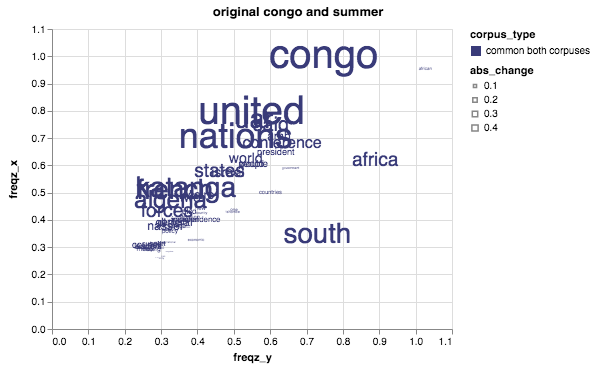

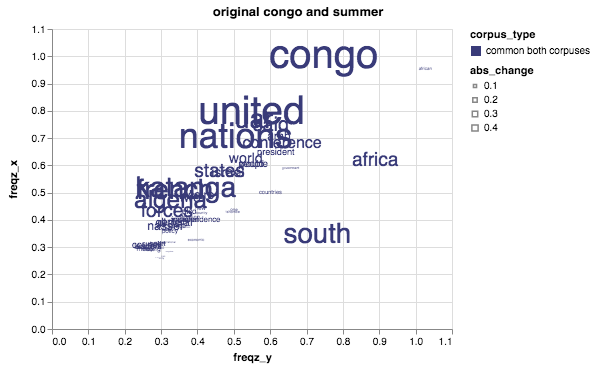

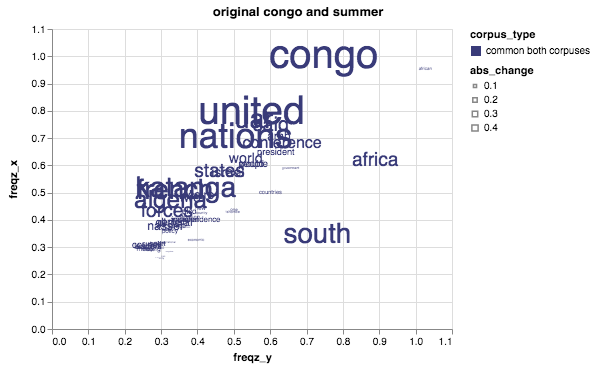

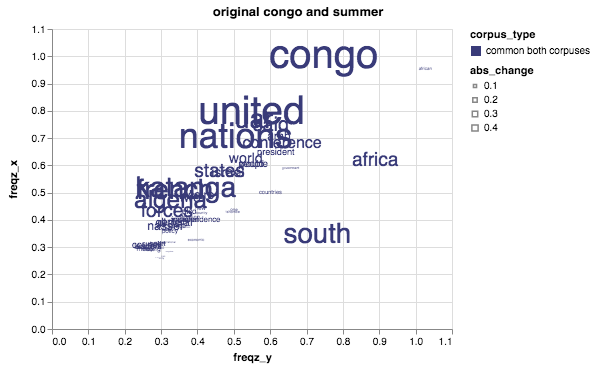

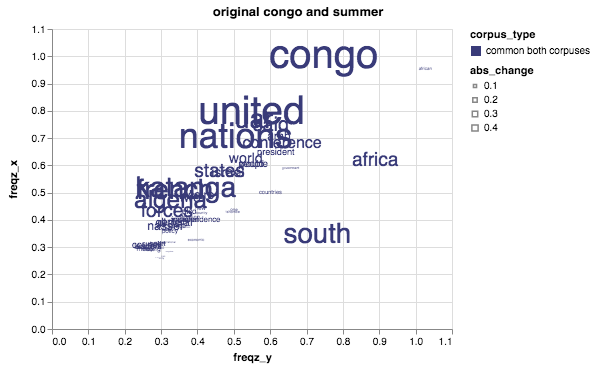

In [62]:

chart1 = alt.Chart(t2t4_both).mark_circle().encode(
    x='freqz_y:Q',
    y='freqz_x:Q',
    size='abs_change:Q',
    color=alt.Color('corpus_type:N', scale=alt.Scale(scheme='category20b')),
    tooltip=['term', 'abs_change', 'freqz_y', 'freqz_x']
).mark_text(
    align='left',
    baseline='middle',
        size=10,
    dx=3  # Nudges text to right so it doesn't appear on top of the bar
).encode(
    text='term:N'
).properties(title='original congo and summer').interactive()




chart1 

In [111]:
t2t4_2.corpus_type[t2t4_2.corpus_type == 'congo split'] = 'congo pages only'
t2t4_2.corpus_type[t2t4_2.corpus_type == 'summer split'] = 'full issues'

In [117]:


total_freq2 = alt.Chart(t2t4_2).mark_bar().encode(
    x=alt.X('freq_y:Q', axis=alt.Axis(title='TF-IDF weight')),
    y=alt.Y(
        'term:N',
         sort=alt.EncodingSortField(
            field="freq_y",  # The field to use for the sort
            op="sum",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )
    ),
    color='corpus_type:N'

).properties(title='Full Corpus Summer 1960 Normalized', height=800, width=200)


congo_freq2 = alt.Chart(t2t4_1).mark_bar().encode(
    x=alt.X('freq_x:Q', axis=alt.Axis(title='TF-IDF weight')),
    y=alt.Y(
        'term:N',
         sort=alt.EncodingSortField(
            field="freq_x",  # The field to use for the sort
            op="sum",  # The operation to run on the field prior to sorting
            order="descending"  # The order to sort in
        )
    ),
    color=alt.Color('corpus_type:N')

).properties(title='Congo Corpus Summer 1960 Normalized', height=800, width=200)
alt.themes.enable('opaque')
charts = alt.hconcat(congo_freq2 | total_freq2 ).configure_axisX(labelAngle=0, labels=False)
charts.save('congo_full_summer1960.png', scale_factor=2.0)

In [183]:
t1t3_1

,freq_x,term,type_x,freqz_x,doc_x,value_x,freq_y,type_y,freqz_y,doc_y,value_y,corpus_type


In [82]:
list1_terms = t2t4_1.loc[t2t4_1.corpus_type == 'congo split']
list1_terms = list1_terms.term.tolist()

In [83]:
list2_terms = t2t4_2.loc[(t2t4_2.corpus_type == 'summer split') ]
list2_terms = list2_terms.term.tolist()
len(list1_terms), len(list2_terms)

(37, 37)

In [84]:

docs1_terms = test2.loc[test2.term.isin(list1_terms)]
docs2_terms = test4.loc[test4.term.isin(list2_terms)]

In [85]:
docs1_terms = docs1_terms.loc[docs1_terms.value != 0]

docs1_terms.sort_values(by=['doc', 'value'], ascending=[True, False], inplace=True)
ec = early_congo.copy()
def len_pages(rows):
    return [len(rows) * sum(rows), len(rows), sum(rows)]

z = docs1_terms.groupby('doc')['value'].apply(len_pages).reset_index()
len(z)
ec[['weighted_val', 'row_count', 'sum_weights']] = pd.DataFrame(z.value.values.tolist(), index= z.index)

In [87]:
docs2_terms = docs2_terms.loc[docs2_terms.value != 0]

docs2_terms.sort_values(by=['doc', 'value'], ascending=[True, False], inplace=True)
len(docs2_terms)
lc = late_congo.copy()
# lc = lc[:350]
def len_pages(rows):
#     print('weight', len(rows) * sum(rows), 'count', len(rows), 'sum', sum(rows))
    return [len(rows) * sum(rows), len(rows), sum(rows)]

z = docs2_terms.groupby('doc')['value'].apply(len_pages).reset_index()
b = pd.DataFrame(z.value.values.tolist(), index= z.index, columns=['weighted_val', 'row_count', 'sum_weights'])
# b.rename(columns={})

In [88]:
len(b), len(late_congo)

(394, 395)

In [89]:
lc.reset_index(drop=True, inplace=True)
lc['weighted_val'] = b.weighted_val
lc['row_count'] = b.row_count
lc['sum_weights'] = b.sum_weights

In [90]:
ec['classify'] = 'early_congo'
lc['classify'] = 'late_congo'

In [171]:
ec = pd.read_csv('../data/early_congo_identified_pages.csv')

In [173]:
ec2 = ec.copy()
lc2 = lc.copy()
len(ec2), len(lc2)

(462, 350)

In [172]:
lc = pd.read_csv('../data/late_congo_identified_pages.csv')

In [47]:
ec.sort_values(by=['weighted_val'], ascending=False, inplace=True)
lc.sort_values(by=['weighted_val'], ascending=False, inplace=True)
ec.reset_index(drop=True, inplace=True)
ec[['weighted_val']] = ec[['weighted_val']].apply(lambda x: (x-x.min())/(x.max()-x.min())+ 0.000001)
lc[['weighted_val']] = lc[['weighted_val']].apply(lambda x: (x-x.min())/(x.max()-x.min())+ 0.000001)

In [91]:
ec.sort_values(by=['sum_weights'], ascending=False, inplace=True)
lc.sort_values(by=['sum_weights'], ascending=False, inplace=True)
ec.reset_index(drop=True, inplace=True)
# ec[['weighted_val']] = ec[['weighted_val']].apply(lambda x: (x-x.min())/(x.max()-x.min())+ 0.000001)
# lc[['weighted_val']] = lc[['weighted_val']].apply(lambda x: (x-x.min())/(x.max()-x.min())+ 0.000001)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x10d930fd0>]],
      dtype=object)

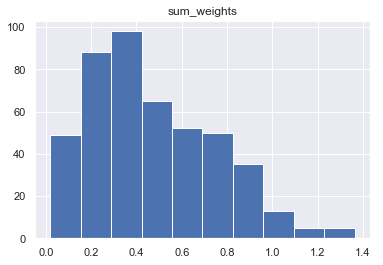

In [71]:
ec.hist(column='sum_weights')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x12e6d6be0>]],
      dtype=object)

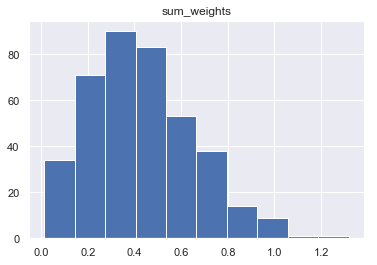

In [72]:
lc.hist(column='sum_weights')

In [74]:
len(lc.loc[lc.weighted_val >lc.weighted_val.mean()])

168

In [75]:
lc.sum_weights.median(), ec.weighted_val.mean()

(4.024815342089523, 4.630008024756661)

In [92]:
ec2 = ec.loc[ec.sum_weights > ec.sum_weights.median()] 
lc2 = lc.loc[lc.sum_weights > lc.sum_weights.median()]

In [81]:
len(ec2), len(lc2)

(230, 197)

In [93]:
ec2.to_csv('../data/early_congo_identified_pages_runmaxdf3050wordsweightedmedian.csv')
lc2.to_csv('../data/late_congo_identified_pages_runmaxdf3050wordsweightedmedian.csv')